Detailed explanation:
https://medium.com/@alexppppp/how-to-create-synthetic-dataset-for-computer-vision-keypoint-detection-78ba481cdafd

GitHub repo:
https://github.com/alexppppp/synthetic-dataset-keypoint-detection

# 1. Imports

In [1]:
import os
import cv2
import json
import numpy as np
import matplotlib.pyplot as plt
import albumentations as A
import time
from tqdm import tqdm

# 2. Paths to files

In [2]:
PATH_MAIN = "data"

files_imgs = sorted(os.listdir(os.path.join(PATH_MAIN, 'images')))
files_imgs = [os.path.join(PATH_MAIN, 'images', f) for f in files_imgs]
files_masks = sorted(os.listdir(os.path.join(PATH_MAIN, 'masks')))
files_masks = [os.path.join(PATH_MAIN, 'masks', f) for f in files_masks]
files_keypoints = sorted(os.listdir(os.path.join(PATH_MAIN, 'keypoints')))
files_keypoints = [os.path.join(PATH_MAIN, 'keypoints', f) for f in files_keypoints]

print("The first five files from the sorted list of object images:", files_imgs[:5])
print("\nThe first five files from the sorted list of object masks:", files_masks[:5])
print("\nThe first five files from the sorted list of object keypoints:", files_keypoints[:5])

files_bg_imgs = os.listdir(os.path.join(PATH_MAIN, 'bg'))
files_bg_imgs = [os.path.join(PATH_MAIN, 'bg', f) for f in files_bg_imgs]
files_bg_noise_imgs = os.listdir(os.path.join(PATH_MAIN, "bg_noise", "images"))
files_bg_noise_imgs = [os.path.join(PATH_MAIN, "bg_noise", "images", f) for f in files_bg_noise_imgs]
files_bg_noise_masks = os.listdir(os.path.join(PATH_MAIN, "bg_noise", "masks"))
files_bg_noise_masks = [os.path.join(PATH_MAIN, "bg_noise", "masks", f) for f in files_bg_noise_masks]

print("\nThe first five files from the sorted list of background images:", files_bg_imgs[:5])
print("\nThe first five files from the sorted list of background noise images:", files_bg_noise_imgs[:5])
print("\nThe first five files from the sorted list of background noise masks:", files_bg_noise_masks[:5])

The first five files from the sorted list of object images: ['data\\images\\1.jpg', 'data\\images\\10.jpg', 'data\\images\\11.jpg', 'data\\images\\12.jpg', 'data\\images\\13.jpg']

The first five files from the sorted list of object masks: ['data\\masks\\1.png', 'data\\masks\\10.png', 'data\\masks\\11.png', 'data\\masks\\12.png', 'data\\masks\\13.png']

The first five files from the sorted list of object keypoints: ['data\\keypoints\\1.json', 'data\\keypoints\\10.json', 'data\\keypoints\\11.json', 'data\\keypoints\\12.json', 'data\\keypoints\\13.json']

The first five files from the sorted list of background images: ['data\\bg\\bg_1.jpg', 'data\\bg\\bg_10.jpg', 'data\\bg\\bg_11.jpg', 'data\\bg\\bg_12.jpg', 'data\\bg\\bg_13.jpg']

The first five files from the sorted list of background noise images: ['data\\bg_noise\\images\\1.png', 'data\\bg_noise\\images\\10.jpg', 'data\\bg_noise\\images\\100.jpg', 'data\\bg_noise\\images\\101.png', 'data\\bg_noise\\images\\102.png']

The first five f

# 3. Images, masks and keypoints

In [3]:
def get_img_and_mask(img_path, mask_path):

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    mask = cv2.imread(mask_path)
    mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
    
    mask_b = mask[:,:,0] == 0 # This is boolean mask
    mask = mask_b.astype(np.uint8) # This is binary mask
    
    return img, mask

In [4]:
def visualize_single_img_with_keypoints(img,
                                        mask,
                                        keypoints,
                                        keypoints_names, title,
                                        draw_bboxes=False):
    
    xmin = np.min(np.where(mask)[1])
    xmax = np.max(np.where(mask)[1])
    ymin = np.min(np.where(mask)[0])
    ymax = np.max(np.where(mask)[0])
    bbox = np.array([xmin, ymin, xmax, ymax])

    start_point = (bbox[0], bbox[1])
    end_point = (bbox[2], bbox[3])
    
    if draw_bboxes:
        img = cv2.rectangle(img.copy(), start_point, end_point, (255,0,0), 2)
    
    for idx, kp in enumerate(keypoints):
        img = cv2.circle(img.copy(), tuple(kp[:2]), 3, (255,0,0), 6)
        img = cv2.putText(img.copy(), " " + keypoints_names[idx], tuple(kp[:2]), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2, cv2.LINE_AA)
        
    plt.figure(figsize=(16,16))
    plt.title(title, fontsize=18)
    plt.imshow(img)
    
keypoints_names = ['Head', 'Tail']

## 3.1. Object of interest (with keypoints)

Image file: data\images\5.jpg
Mask file: data\masks\5.png

Shape of the image of the object: (735, 1111, 3)
Shape of the binary mask: (735, 1111)


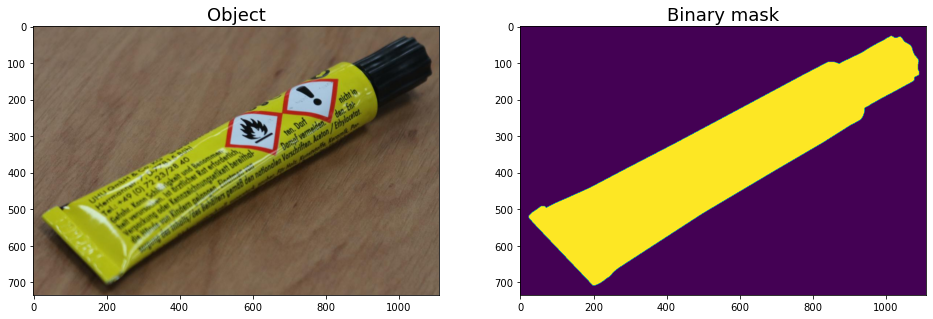

In [5]:
# Let's look at a random object and its binary mask

img_path = files_imgs[9]
mask_path = files_masks[9]

img, mask = get_img_and_mask(img_path, mask_path)

print("Image file:", img_path)
print("Mask file:", mask_path)
print("\nShape of the image of the object:", img.shape)
print("Shape of the binary mask:", mask.shape)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(img)
ax[0].set_title('Object', fontsize=18)
ax[1].imshow(mask)
ax[1].set_title('Binary mask', fontsize=18);

Keypoints: [[979, 103, 1], [132, 594, 1]]


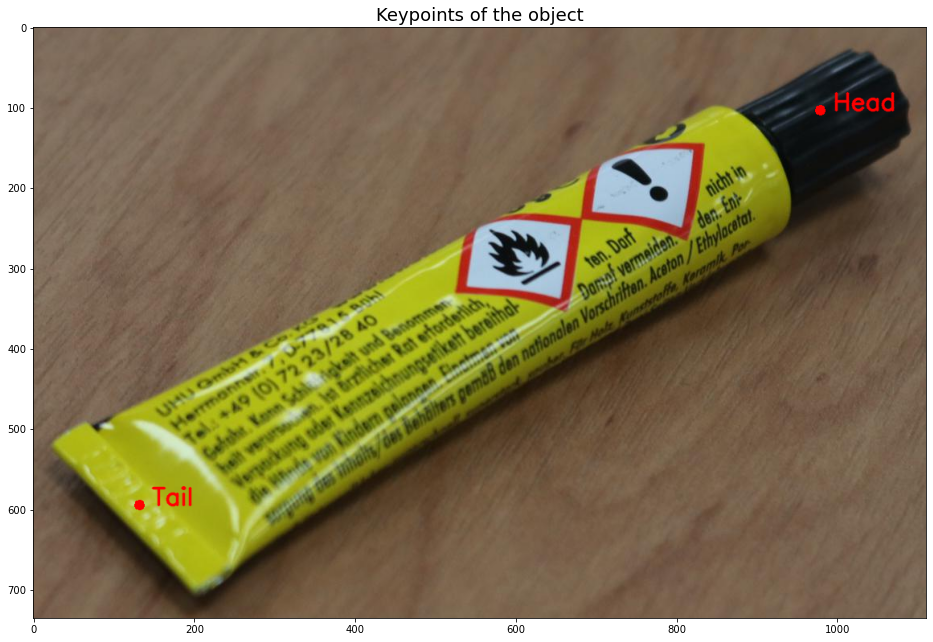

In [6]:
with open(files_keypoints[9]) as f:
    data = json.load(f)
    keypoints = data['keypoints']
    
print("Keypoints:", keypoints)

visualize_single_img_with_keypoints(img, mask, keypoints, keypoints_names, title="Keypoints of the object")

## 3.2. Background noise object (without keypoints)

Image file: data\bg_noise\images\18.jpg
Mask file: data\bg_noise\masks\18.png

Shape of the image of the object: (1280, 1073, 3)
Shape of the binary mask: (1280, 1073)


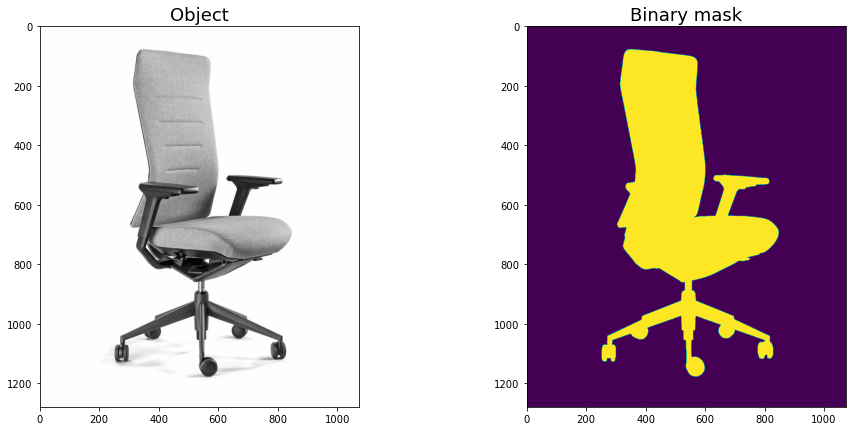

In [7]:
bg_img_path = files_bg_noise_imgs[17]
bg_mask_path = files_bg_noise_masks[17]

bg_img, bg_mask = get_img_and_mask(bg_img_path, bg_mask_path)

print("Image file:", bg_img_path)
print("Mask file:", bg_mask_path)
print("\nShape of the image of the object:", bg_img.shape)
print("Shape of the binary mask:", bg_mask.shape)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(bg_img)
ax[0].set_title('Object', fontsize=18)
ax[1].imshow(bg_mask)
ax[1].set_title('Binary mask', fontsize=18);

# 4. Resizing background images

In [8]:
def resize_img(img, desired_max, desired_min=None):
   
    h, w = img.shape[0], img.shape[1]
    
    longest, shortest = max(h, w), min(h, w)
    longest_new = desired_max
    if desired_min:
        shortest_new = desired_min
    else:
        shortest_new = int(shortest * (longest_new / longest))
    
    if h > w:
        h_new, w_new = longest_new, shortest_new
    else:
        h_new, w_new = shortest_new, longest_new
        
    transform_resize = A.Compose([
        A.Sequential([
        A.Resize(h_new, w_new, interpolation=1, always_apply=False, p=1)
        ], p=1)
    ])

    transformed = transform_resize(image=img)
    img_r = transformed["image"]
        
    return img_r

Shape of the original background image: (3068, 2454, 3)
Shape of the resized background image (desired_max=1920, desired_min=None): (1920, 1535, 3)
Shape of the resized background image (desired_max=1920, desired_min=1080): (1920, 1080, 3)


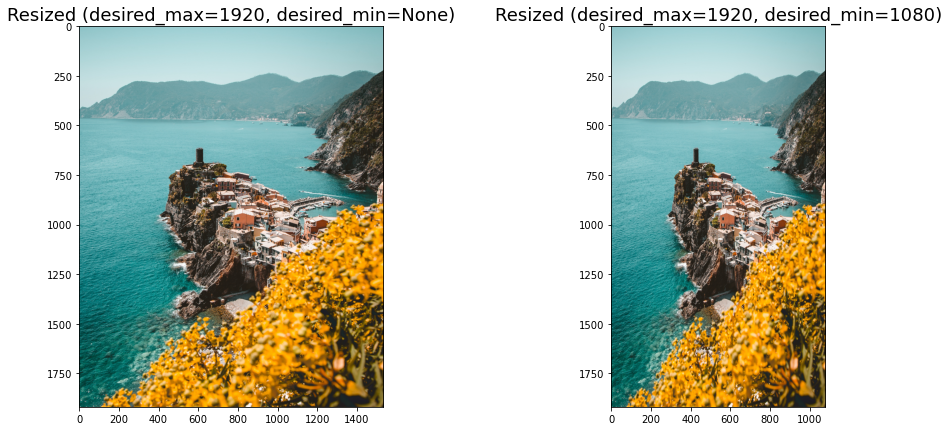

In [9]:
# Let's look how a random background image can be resized with resize_img() function

img_bg_path = files_bg_imgs[5]
img_bg = cv2.imread(img_bg_path)
img_bg = cv2.cvtColor(img_bg, cv2.COLOR_BGR2RGB)

img_bg_resized_1 = resize_img(img_bg, desired_max=1920, desired_min=None)
img_bg_resized_2 = resize_img(img_bg, desired_max=1920, desired_min=1080)

print("Shape of the original background image:", img_bg.shape)

print("Shape of the resized background image (desired_max=1920, desired_min=None):", img_bg_resized_1.shape)
print("Shape of the resized background image (desired_max=1920, desired_min=1080):", img_bg_resized_2.shape)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(img_bg_resized_1)
ax[0].set_title('Resized (desired_max=1920, desired_min=None)', fontsize=18)
ax[1].imshow(img_bg_resized_2)
ax[1].set_title('Resized (desired_max=1920, desired_min=1080)', fontsize=18);

# 5. Resizing and transforming objects of interest (with keypoints)

In [10]:
def resize_transform_obj(img,
                         mask,
                         longest_min,
                         longest_max,
                         keypoints,
                         transforms=False):
   
    h, w = mask.shape[0], mask.shape[1]
    
    longest, shortest = max(h, w), min(h, w)
    longest_new = np.random.randint(longest_min, longest_max)
    shortest_new = int(shortest * (longest_new / longest))
    
    if h > w:
        h_new, w_new = longest_new, shortest_new
    else:
        h_new, w_new = shortest_new, longest_new
        
    keypoints_2 = [kp[0:2] for kp in keypoints]
        
    transform_resize = A.Compose([A.Resize(h_new,
                                           w_new,
                                           interpolation=1,
                                           always_apply=False,
                                           p=1)],
                                 keypoint_params=A.KeypointParams(format='xy'))
    
    transformed_resized = transform_resize(image=img,
                                           mask=mask,
                                           keypoints=keypoints_2)
    img_t = transformed_resized["image"]
    mask_t = transformed_resized["mask"]
    keypoints_2_t = transformed_resized["keypoints"]        

    if transforms:    
        transformed = transforms(image=img_t,
                                 mask=mask_t,
                                 keypoints=keypoints_2_t)
        img_t = transformed["image"]
        mask_t = transformed["mask"]
        keypoints_2_t = transformed["keypoints"]

    keypoints_t = []
    for idx, kp in enumerate(keypoints_2_t):
        keypoints_t.append(list(map(int, kp)) + [keypoints[idx][2]])       
        
    return img_t, mask_t, keypoints_t

transforms_obj = A.Compose([
    A.RandomRotate90(p=1),
    A.RandomBrightnessContrast(brightness_limit=(-0.1, 0.2),
                               contrast_limit=0.1,
                               brightness_by_max=True,
                               always_apply=False,
                               p=1)
],
keypoint_params=A.KeypointParams(format='xy'))


Shape of the image of the transformed object: (983, 650, 3)
Shape of the transformed binary mask: (983, 650, 3)


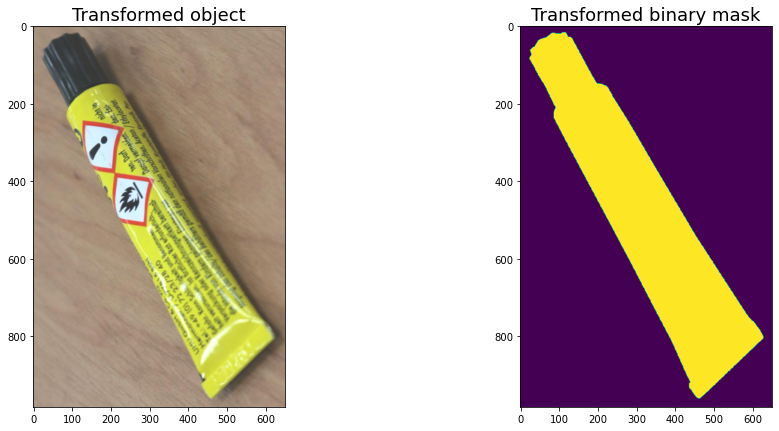

In [69]:
img_path = files_imgs[9]
mask_path = files_masks[9]
img, mask = get_img_and_mask(img_path, mask_path)

with open(files_keypoints[9]) as f:
    data = json.load(f)
    keypoints = data['keypoints']

img_t, mask_t, keypoints_t = resize_transform_obj(img,
                                                  mask,
                                                  longest_min=900,
                                                  longest_max=1000,
                                                  keypoints=keypoints,
                                                  transforms=transforms_obj)

print("\nShape of the image of the transformed object:", img_t.shape)
print("Shape of the transformed binary mask:", img_t.shape)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(img_t)
ax[0].set_title('Transformed object', fontsize=18)
ax[1].imshow(mask_t)
ax[1].set_title('Transformed binary mask', fontsize=18);

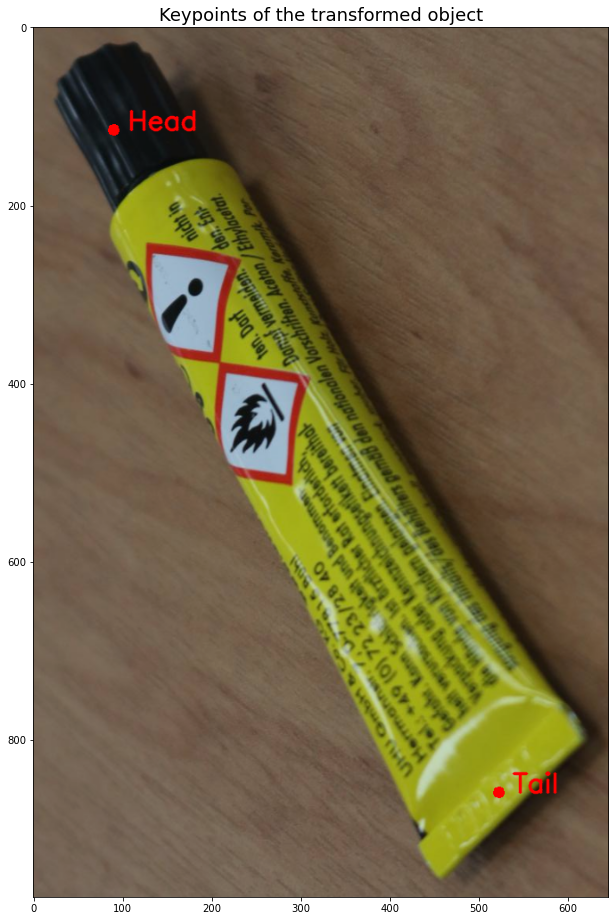

In [57]:
visualize_single_img_with_keypoints(img_t,
                                    mask_t,
                                    keypoints_t,
                                    keypoints_names,
                                    title="Keypoints of the transformed object")

# 6. Resizing and transforming background noise objects (without keypoints)

In [11]:
def resize_transform_bg_obj(img,
                            mask,
                            longest_min,
                            longest_max,
                            transforms=False):
   
    h, w = mask.shape[0], mask.shape[1]
    
    longest, shortest = max(h, w), min(h, w)
    longest_new = np.random.randint(longest_min, longest_max)
    shortest_new = int(shortest * (longest_new / longest))
    
    if h > w:
        h_new, w_new = longest_new, shortest_new
    else:
        h_new, w_new = shortest_new, longest_new
        
    transform_resize = A.Resize(h_new,
                                w_new,
                                interpolation=1,
                                always_apply=False,
                                p=1)
    
    transformed_resized = transform_resize(image=img, mask=mask)
    img_t = transformed_resized["image"]
    mask_t = transformed_resized["mask"]

    if transforms:    
        transformed = transforms(image=img_t, mask=mask_t)
        img_t = transformed["image"]
        mask_t = transformed["mask"]  
        
    return img_t, mask_t

transforms_bg_obj = A.Compose([
    A.RandomRotate90(p=1),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.07, always_apply=False, p=1),
    A.Blur(blur_limit=(3,15), always_apply=False, p=0.5)
])


Shape of the image of the transformed object: (820, 979, 3)
Shape of the transformed binary mask: (820, 979)


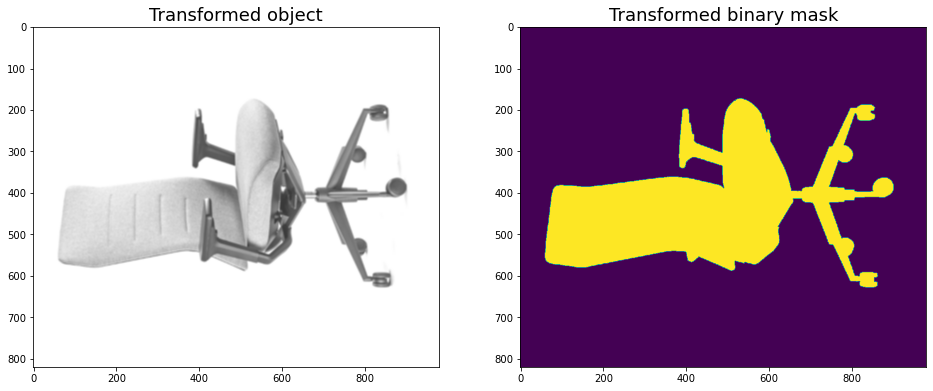

In [109]:
bg_img_t, bg_mask_t = resize_transform_bg_obj(bg_img,
                                              bg_mask,
                                              longest_min=900,
                                              longest_max=1000,
                                              transforms=transforms_bg_obj)

print("\nShape of the image of the transformed object:", bg_img_t.shape)
print("Shape of the transformed binary mask:", bg_mask_t.shape)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(bg_img_t)
ax[0].set_title('Transformed object', fontsize=18)
ax[1].imshow(bg_mask_t)
ax[1].set_title('Transformed binary mask', fontsize=18);

# 7. Adding objects of interest (with keypoints) to background

In [12]:
def add_obj(img_comp, mask_comp, keypoints_comp, img, mask, keypoints, x, y, idx):
    '''
    img_comp - composition of objects
    mask_comp - composition of objects` masks
    keypoints_comp - composition of keypoints
    img - image of object
    mask - mask of object
    keypoints - keypoints of object
    x, y - coordinates where left top corner of img is placed
    Function returns img_comp in CV2 RGB format + mask_comp + keypoints_comp as a list
    '''
    h_comp, w_comp = img_comp.shape[0], img_comp.shape[1]    
    h, w = img.shape[0], img.shape[1]   
    mask_b = mask == 1
    mask_rgb_b = np.stack([mask_b, mask_b, mask_b], axis=2)
    
    img_comp[y:y+h, x:x+w, :] = img_comp[y:y+h, x:x+w, :] * ~mask_rgb_b + (img * mask_rgb_b)
    mask_comp[y:y+h, x:x+w] = mask_comp[y:y+h, x:x+w] * ~mask_b + (idx * mask_b)
    keypoints_comp.append([[kp[0] + x, kp[1] + y, kp[2]] for kp in keypoints])
    
    return img_comp, mask_comp, keypoints_comp

In [13]:
def visualize_composition_with_keypoints(img_comp, keypoints_comp, keypoints_names, bboxes_comp=None):
    
    if bboxes_comp:
        for bbox in bboxes_comp:
            start_point, end_point = tuple([bbox[0], bbox[1]]), tuple([bbox[2], bbox[3]])
            img_comp = cv2.rectangle(img_comp.copy(), start_point, end_point, (255,0,0), 2)
    
    for keypoints in keypoints_comp:
        for idx, kp in enumerate(keypoints):
            img_comp = cv2.circle(img_comp.copy(), tuple(kp[:2]), 3, (255,0,0), 6)
            img_comp = cv2.putText(img_comp.copy(), " " + keypoints_names[idx], tuple(kp[:2]), cv2.FONT_HERSHEY_SIMPLEX, 2, (255,0,0), 4, cv2.LINE_AA)
        
    plt.figure(figsize=(40,40))
    plt.imshow(img_comp)

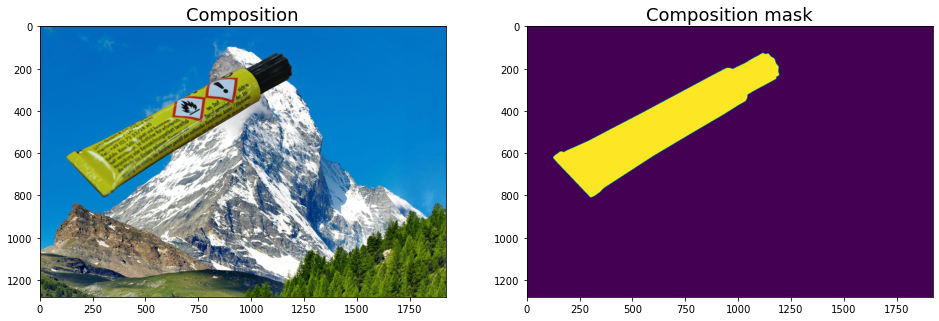

In [156]:
img_bg_path = files_bg_imgs[44]
img_bg = cv2.imread(img_bg_path)
img_bg = cv2.cvtColor(img_bg, cv2.COLOR_BGR2RGB)

h, w = img_bg.shape[0], img_bg.shape[1]
mask_comp = np.zeros((h,w), dtype=np.uint8)
keypoints_comp = []

img_comp, mask_comp, keypoints_comp = add_obj(img_bg,
                                              mask_comp,
                                              keypoints_comp,
                                              img,
                                              mask,
                                              keypoints,
                                              x=100,
                                              y=100,
                                              idx=1)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(img_comp)
ax[0].set_title('Composition', fontsize=18)
ax[1].imshow(mask_comp)
ax[1].set_title('Composition mask', fontsize=18);

Keypoints: [[[1079, 203, 1], [232, 694, 1]]]


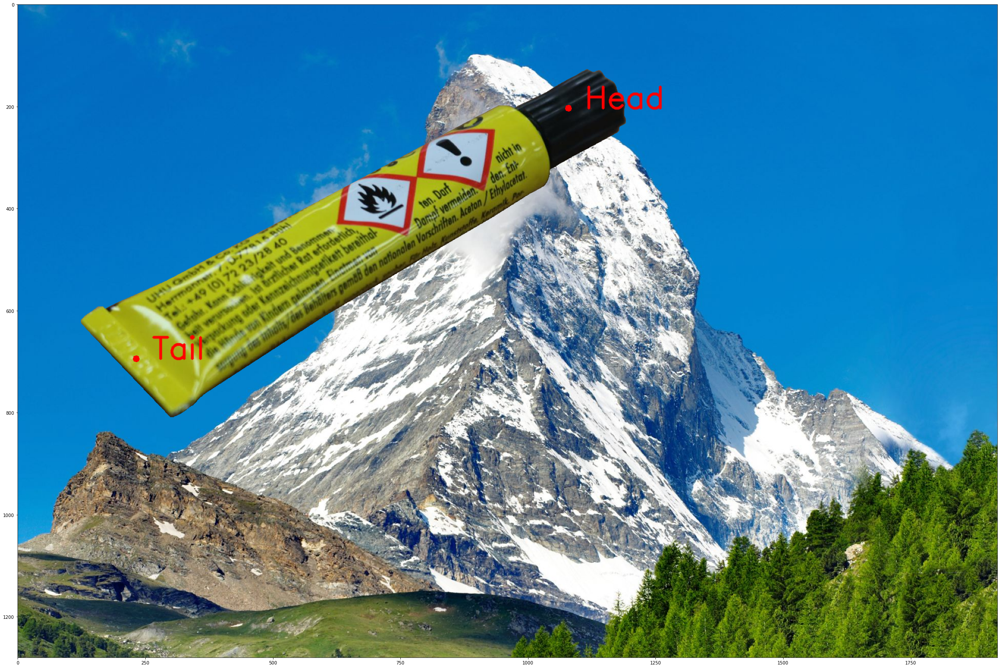

In [157]:
print("Keypoints:", keypoints_comp)
visualize_composition_with_keypoints(img_comp, keypoints_comp, keypoints_names)

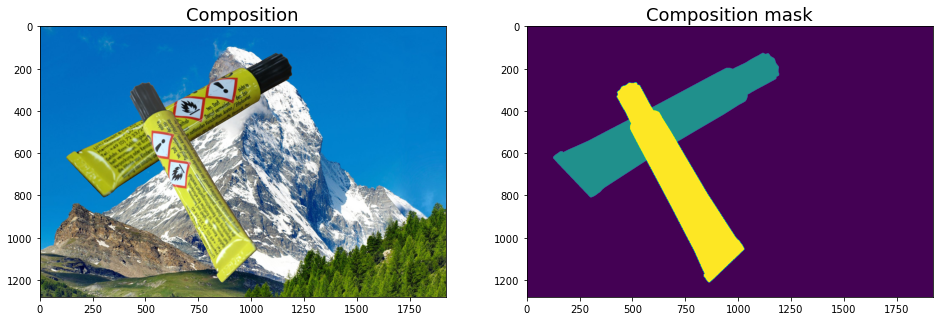

In [158]:
img_comp, mask_comp, keypoints_comp = add_obj(img_comp,
                                              mask_comp,
                                              keypoints_comp,
                                              img_t,
                                              mask_t,
                                              keypoints_t,
                                              x=400,
                                              y=250,
                                              idx=2)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(img_comp)
ax[0].set_title('Composition', fontsize=18)
ax[1].imshow(mask_comp)
ax[1].set_title('Composition mask', fontsize=18);

Keypoints: [[[1079, 203, 1], [232, 694, 1]], [[491, 365, 1], [925, 1115, 1]]]


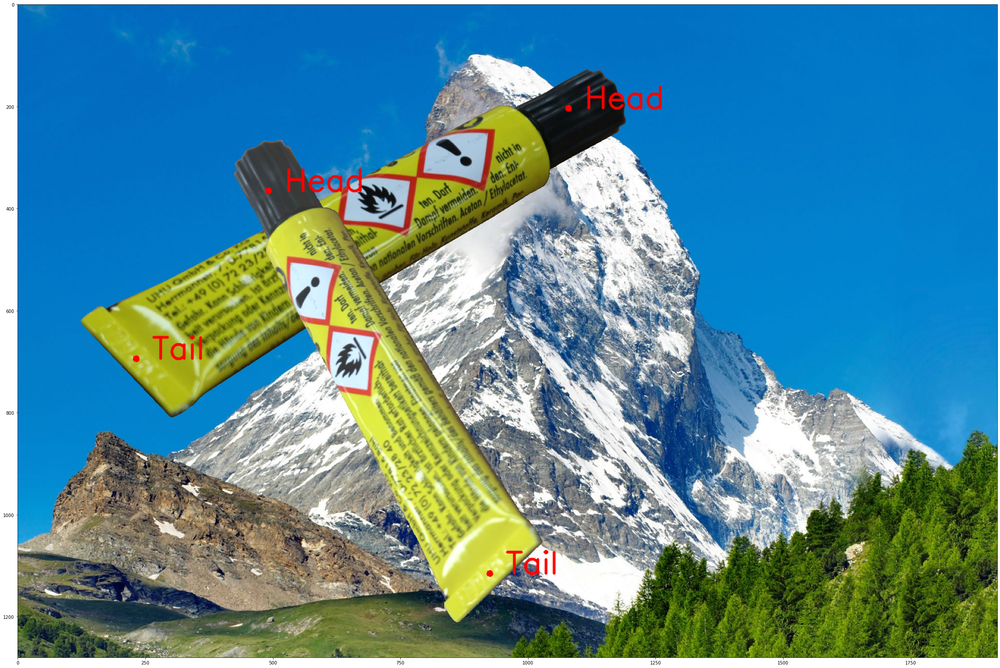

In [159]:
print("Keypoints:", keypoints_comp)
visualize_composition_with_keypoints(img_comp, keypoints_comp, keypoints_names)

# 8. Adding noise objects (without keypoints) to background

## 8.1. Adding one object

In [14]:
def add_bg_obj(img_comp, mask_comp, img, mask, x, y, idx):
    '''
    img_comp - composition of objects
    mask_comp - composition of objects` masks
    img - image of object
    mask - binary mask of object
    x, y - coordinates where center of img is placed
    Function returns img_comp in CV2 RGB format + mask_comp
    '''
    h_comp, w_comp = img_comp.shape[0], img_comp.shape[1]
    
    h, w = img.shape[0], img.shape[1]
    
    x = x - int(w/2)
    y = y - int(h/2)
    
    mask_b = mask == 1
    mask_rgb_b = np.stack([mask_b, mask_b, mask_b], axis=2)
    
    if x >= 0 and y >= 0:
    
        h_part = h - max(0, y+h-h_comp) # h_part - part of the image which gets into the frame of img_comp along y-axis
        w_part = w - max(0, x+w-w_comp) # w_part - part of the image which gets into the frame of img_comp along x-axis

        img_comp[y:y+h_part, x:x+w_part, :] = img_comp[y:y+h_part, x:x+w_part, :] * ~mask_rgb_b[0:h_part, 0:w_part, :] + (img * mask_rgb_b)[0:h_part, 0:w_part, :]
        mask_comp[y:y+h_part, x:x+w_part] = mask_comp[y:y+h_part, x:x+w_part] * ~mask_b[0:h_part, 0:w_part] + (idx * mask_b)[0:h_part, 0:w_part]
        
    elif x < 0 and y < 0:
        
        h_part = h + y
        w_part = w + x
        
        img_comp[0:0+h_part, 0:0+w_part, :] = img_comp[0:0+h_part, 0:0+w_part, :] * ~mask_rgb_b[h-h_part:h, w-w_part:w, :] + (img * mask_rgb_b)[h-h_part:h, w-w_part:w, :]
        mask_comp[0:0+h_part, 0:0+w_part] = mask_comp[0:0+h_part, 0:0+w_part] * ~mask_b[h-h_part:h, w-w_part:w] + (idx * mask_b)[h-h_part:h, w-w_part:w]
        
    elif x < 0 and y >= 0:
        
        h_part = h - max(0, y+h-h_comp)
        w_part = w + x
        
        img_comp[y:y+h_part, 0:0+w_part, :] = img_comp[y:y+h_part, 0:0+w_part, :] * ~mask_rgb_b[0:h_part, w-w_part:w, :] + (img * mask_rgb_b)[0:h_part, w-w_part:w, :]
        mask_comp[y:y+h_part, 0:0+w_part] = mask_comp[y:y+h_part, 0:0+w_part] * ~mask_b[0:h_part, w-w_part:w] + (idx * mask_b)[0:h_part, w-w_part:w]
       
    elif x >= 0 and y < 0:
        
        h_part = h + y
        w_part = w - max(0, x+w-w_comp)
        
        img_comp[0:0+h_part, x:x+w_part, :] = img_comp[0:0+h_part, x:x+w_part, :] * ~mask_rgb_b[h-h_part:h, 0:w_part, :] + (img * mask_rgb_b)[h-h_part:h, 0:w_part, :]
        mask_comp[0:0+h_part, x:x+w_part] = mask_comp[0:0+h_part, x:x+w_part] * ~mask_b[h-h_part:h, 0:w_part] + (idx * mask_b)[h-h_part:h, 0:w_part]
    
    return img_comp, mask_comp

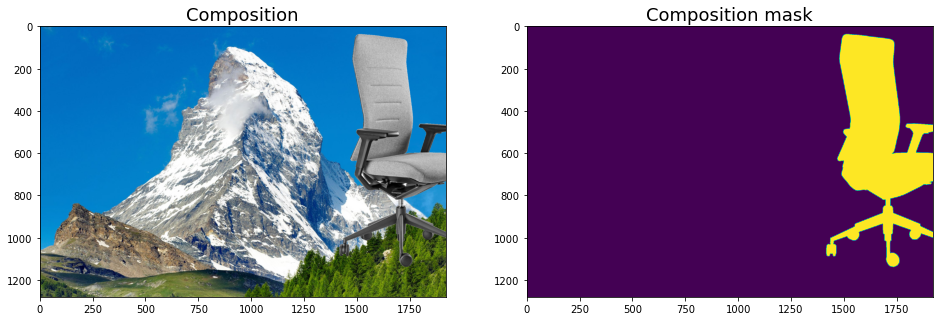

In [114]:
img_bg_path = files_bg_imgs[44]
img_bg = cv2.imread(img_bg_path)
img_bg = cv2.cvtColor(img_bg, cv2.COLOR_BGR2RGB)

h, w = img_bg.shape[0], img_bg.shape[1]
mask_comp = np.zeros((h,w), dtype=np.uint8)

img_comp, mask_comp = add_bg_obj(img_bg, mask_comp, bg_img, bg_mask, x=1700, y=600, idx=1)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(img_comp)
ax[0].set_title('Composition', fontsize=18)
ax[1].imshow(mask_comp)
ax[1].set_title('Composition mask', fontsize=18);

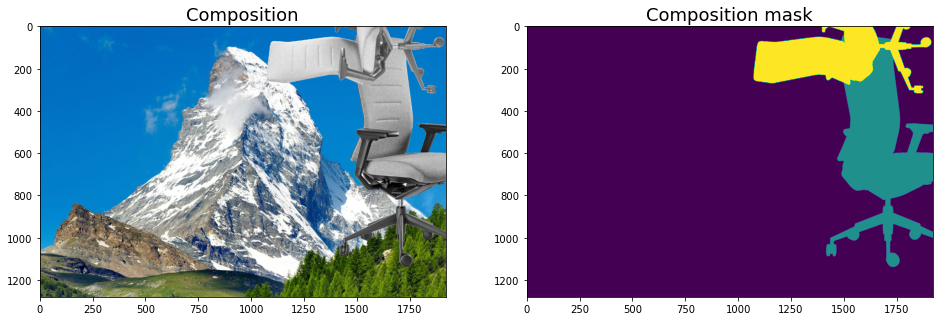

In [112]:
img_comp, mask_comp = add_bg_obj(img_comp, mask_comp, bg_img_t, bg_mask_t, x=1500, y=100, idx=2)

fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(img_comp)
ax[0].set_title('Composition', fontsize=18)
ax[1].imshow(mask_comp)
ax[1].set_title('Composition mask', fontsize=18);

## 8.2. Adding many objects

In [15]:
def create_bg_with_noise(files_bg_imgs,
                         files_bg_noise_imgs,
                         files_bg_noise_masks,
                         bg_max=1920,
                         bg_min=1080,
                         max_objs_to_add=60,
                         longest_bg_noise_max=1000,
                         longest_bg_noise_min=200,
                         blank_bg=False):
    
    if blank_bg:
        img_comp_bg = np.ones((bg_min, bg_max, 3), dtype=np.uint8) * 255
        mask_comp_bg = np.zeros((bg_min, bg_max), dtype=np.uint8)
    else:    
        idx = np.random.randint(len(files_bg_imgs))
        img_bg = cv2.imread(files_bg_imgs[idx])
        img_bg = cv2.cvtColor(img_bg, cv2.COLOR_BGR2RGB)
        img_comp_bg = resize_img(img_bg, bg_max, bg_min)
        mask_comp_bg = np.zeros((img_comp_bg.shape[0], img_comp_bg.shape[1]), dtype=np.uint8)
        
    for i in range(1, np.random.randint(max_objs_to_add) + 2):

        idx = np.random.randint(len(files_bg_noise_imgs))
        img, mask = get_img_and_mask(files_bg_noise_imgs[idx], files_bg_noise_masks[idx])
        x, y = np.random.randint(img_comp_bg.shape[1]), np.random.randint(img_comp_bg.shape[0])
        img_t, mask_t = resize_transform_bg_obj(img, mask, longest_bg_noise_min, longest_bg_noise_max, transforms=transforms_bg_obj)
        img_comp_bg, _ = add_bg_obj(img_comp_bg, mask_comp_bg, img_t, mask_t, x, y, i)
        
    return img_comp_bg

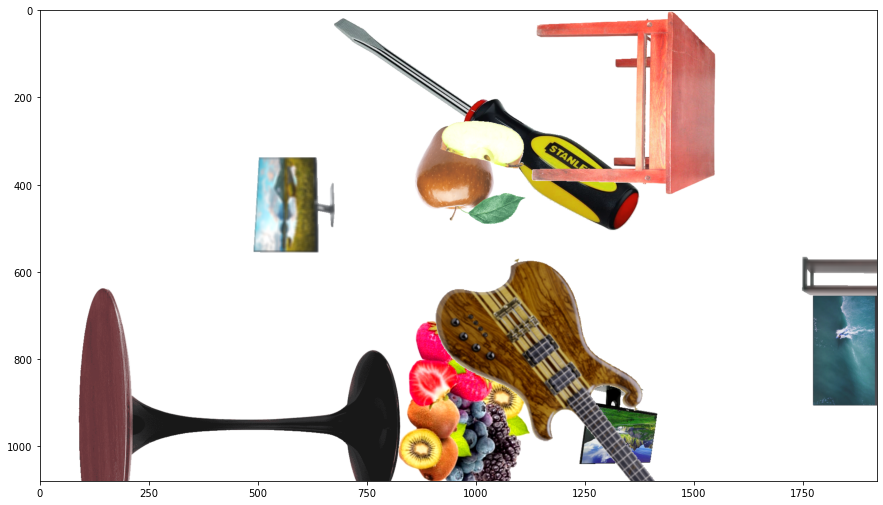

In [171]:
img_comp_bg = create_bg_with_noise(files_bg_imgs,
                                   files_bg_noise_imgs,
                                   files_bg_noise_masks,
                                   max_objs_to_add=20,
                                   blank_bg=True)
plt.figure(figsize=(15,15))
plt.imshow(img_comp_bg)

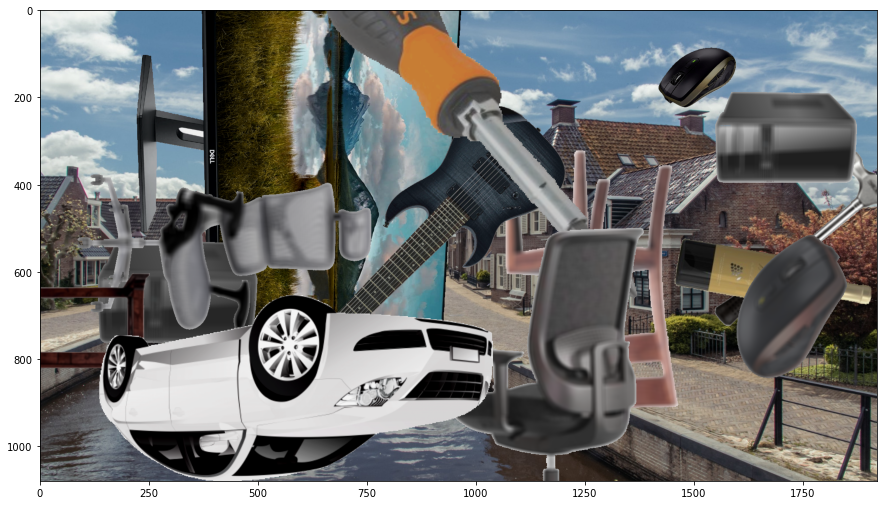

In [173]:
img_comp_bg = create_bg_with_noise(files_bg_imgs,
                                   files_bg_noise_imgs,
                                   files_bg_noise_masks,
                                   max_objs_to_add=20)
plt.figure(figsize=(15,15))
plt.imshow(img_comp_bg)

# 9. Controlling degree of overlapping

In [16]:
def check_overlapping(mask_comp, obj_areas, overlap_degree=0):
    obj_ids = np.unique(mask_comp).astype(np.uint8)[1:-1]
    masks = mask_comp == obj_ids[:, None, None]
    
    ok = True
    
    if len(np.unique(mask_comp)) != np.max(mask_comp) + 1:
        ok = False
        return ok
    
    for idx, mask in enumerate(masks):
        if np.count_nonzero(mask) / obj_areas[idx] < 1 - overlap_degree:
            ok = False
            break
            
    return ok

# 10. Creating synthetic composition

In [17]:
def create_composition(img_comp_bg,
                       max_objs=15,
                       longest_min=300,
                       longest_max=700,
                       overlap_degree=0,
                       max_attempts_per_obj=10):

    img_comp = img_comp_bg.copy()
    h, w = img_comp.shape[0], img_comp.shape[1]
    mask_comp = np.zeros((h,w), dtype=np.uint8)
    keypoints_comp = []
    
    obj_areas = []
    num_objs = np.random.randint(max_objs) + 2
    
    i = 1
    
    for _ in range(1, num_objs):
       
        for _ in range(max_attempts_per_obj):

            imgs_number = len(files_imgs)
            idx = np.random.randint(imgs_number)
            
            img_path = files_imgs[idx]
            mask_path = files_masks[idx]
            keypoints_path = files_keypoints[idx]
            
            img, mask = get_img_and_mask(img_path, mask_path)
            with open(keypoints_path) as f:
                data = json.load(f)
                keypoints = data['keypoints']
                
            img_t, mask_t, keypoints_t = resize_transform_obj(img,
                                                              mask,
                                                              longest_min,
                                                              longest_max,
                                                              keypoints=keypoints,
                                                              transforms=transforms_obj)
            x_max, y_max = img_comp.shape[1] - img_t.shape[1], img_comp.shape[0] - img_t.shape[0]
            x, y = np.random.randint(x_max), np.random.randint(y_max)

            if i == 1:
                img_comp, mask_comp, keypoints_comp = add_obj(img_comp,
                                                              mask_comp,
                                                              keypoints_comp,
                                                              img_t,
                                                              mask_t,
                                                              keypoints_t,
                                                              x,
                                                              y,
                                                              i)
                obj_areas.append(np.count_nonzero(mask_t))
                i += 1
                break
            else:        
                img_comp_prev, mask_comp_prev, keypoints_comp_prev = img_comp.copy(), mask_comp.copy(), keypoints_comp.copy()
                img_comp, mask_comp, keypoints_comp = add_obj(img_comp,
                                                              mask_comp,
                                                              keypoints_comp,
                                                              img_t,
                                                              mask_t,
                                                              keypoints_t,
                                                              x,
                                                              y,
                                                              i)
                ok = check_overlapping(mask_comp, obj_areas, overlap_degree)
                if ok:
                    obj_areas.append(np.count_nonzero(mask_t))
                    i += 1
                    break
                else:
                    img_comp, mask_comp, keypoints_comp = img_comp_prev.copy(), mask_comp_prev.copy(), keypoints_comp_prev.copy()
        
    return img_comp, mask_comp, keypoints_comp

In [18]:
def create_bboxes_from_mask_comp(mask_comp):
    
    height, width = mask_comp.shape[0], mask_comp.shape[1]
    
    obj_ids = np.unique(mask_comp)[1:]
    masks = mask_comp == obj_ids[:, None, None]

    bboxes_comp = []
    
    for i in range(len(obj_ids)):
        pos = np.where(masks[i])
        xmin = np.min(pos[1])
        xmax = np.max(pos[1])
        ymin = np.min(pos[0])
        ymax = np.max(pos[0])

        bboxes_comp.append(list(map(int, [xmin, ymin, xmax, ymax])))

    return bboxes_comp

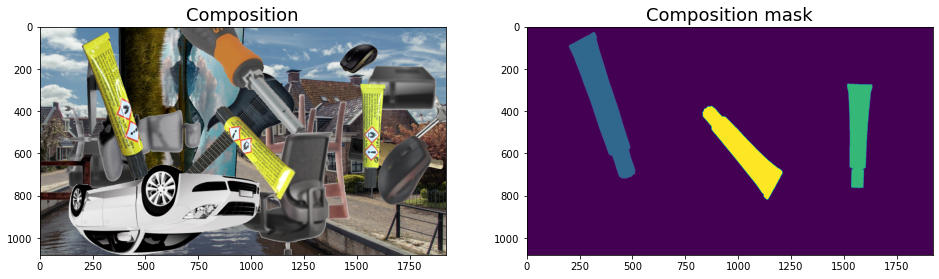

In [215]:
img_comp, mask_comp, keypoints_comp = create_composition(img_comp_bg,
                                                         max_objs=4,
                                                         overlap_degree=0,
                                                         max_attempts_per_obj=10)


fig, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].imshow(img_comp)
ax[0].set_title('Composition', fontsize=18)
ax[1].imshow(mask_comp)
ax[1].set_title('Composition mask', fontsize=18);

Keypoints: [[[473, 652, 1], [266, 72, 1]], [[1564, 716, 1], [1571, 283, 1]], [[862, 423, 1], [1164, 745, 1]]]


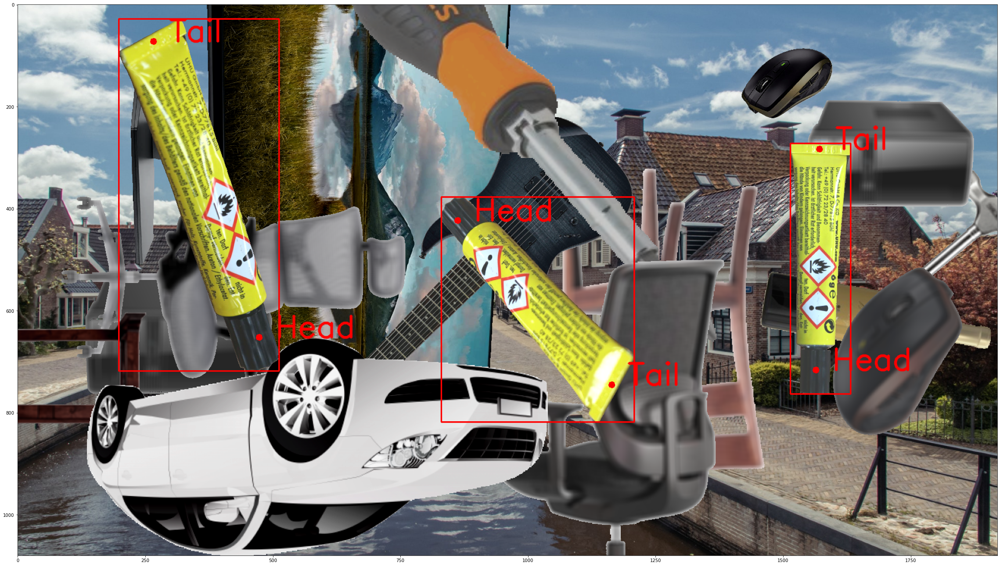

In [216]:
print("Keypoints:", keypoints_comp)

bboxes_comp = create_bboxes_from_mask_comp(mask_comp)

visualize_composition_with_keypoints(img_comp,
                                     keypoints_comp,
                                     keypoints_names,
                                     bboxes_comp)

# 11. Creating and saving synthetic dataset

In [19]:
def generate_dataset(imgs_number, folder, split='train'):
    time_start = time.time()
    for j in tqdm(range(imgs_number)):
        img_comp_bg = create_bg_with_noise(files_bg_imgs,
                                           files_bg_noise_imgs,
                                           files_bg_noise_masks,
                                           max_objs_to_add=60)

        img_comp, mask_comp, keypoints_comp = create_composition(img_comp_bg, max_objs=3,
                                                                 overlap_degree=0,
                                                                 max_attempts_per_obj=10)
        bboxes_comp = create_bboxes_from_mask_comp(mask_comp)

        img_comp = cv2.cvtColor(img_comp, cv2.COLOR_RGB2BGR)
        cv2.imwrite(os.path.join(folder, split, 'images/{}.jpg').format(j), img_comp)

        annotations = {}
        annotations['bboxes'], annotations['keypoints'] = bboxes_comp, keypoints_comp
        with open(os.path.join(folder, split, 'annotations/{}.json').format(j), "w") as f:
            json.dump(annotations, f)    
                
    time_end = time.time()
    time_total = round(time_end - time_start)
    time_per_img = round((time_end - time_start) / imgs_number, 1)
    
    print("Generation of {} synthetic images is completed. It took {} seconds, or {} seconds per image".format(imgs_number, time_total, time_per_img))
    print("Images are stored in '{}'".format(os.path.join(folder, split, 'images')))
    print("Annotations are stored in '{}'".format(os.path.join(folder, split, 'annotations')))

In [20]:
generate_dataset(1000, folder='dataset', split='train')
generate_dataset(200, folder='dataset', split='valid')

  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

Generation of 1000 synthetic images is completed. It took 1033 seconds, or 1.0 seconds per image
Images are stored in 'dataset\train\images'
Annotations are stored in 'dataset\train\annotations'


100%|████████████████████████████████████████████████████████████████████████████████| 200/200 [03:19<00:00,  1.00it/s]

Generation of 200 synthetic images is completed. It took 199 seconds, or 1.0 seconds per image
Images are stored in 'dataset\valid\images'
Annotations are stored in 'dataset\valid\annotations'


# 12. Example from synthetic dataset

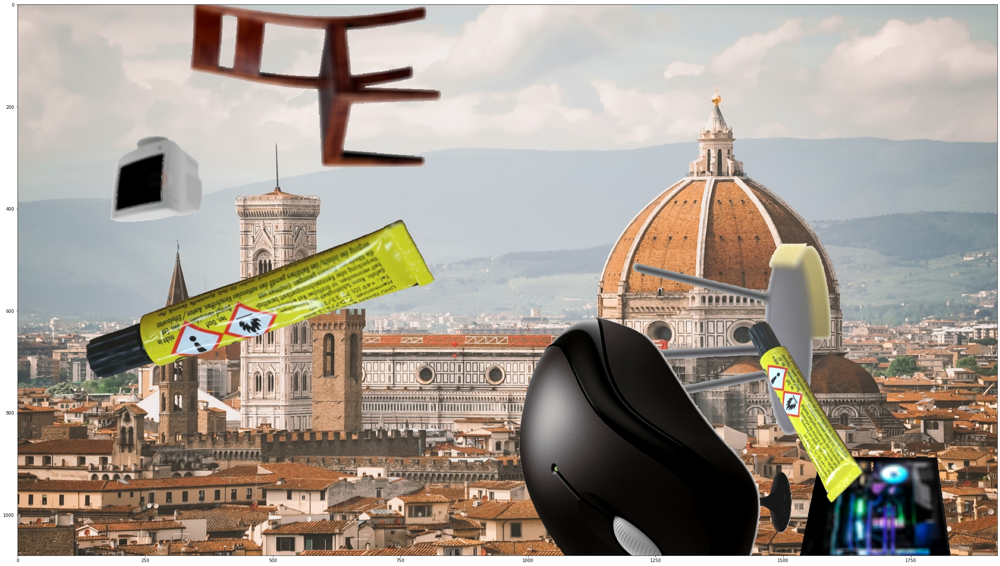

In [42]:
img_dataset_example = cv2.imread('dataset/valid/images/69.jpg')
img_dataset_example = cv2.cvtColor(img_dataset_example, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(40,40))
plt.imshow(img_dataset_example)

In [43]:
with open('dataset/valid/annotations/69.json', 'r') as f:
        data = json.load(f)
        bboxes_dataset_example = data['bboxes']
        keypoints_dataset_example = data['keypoints']

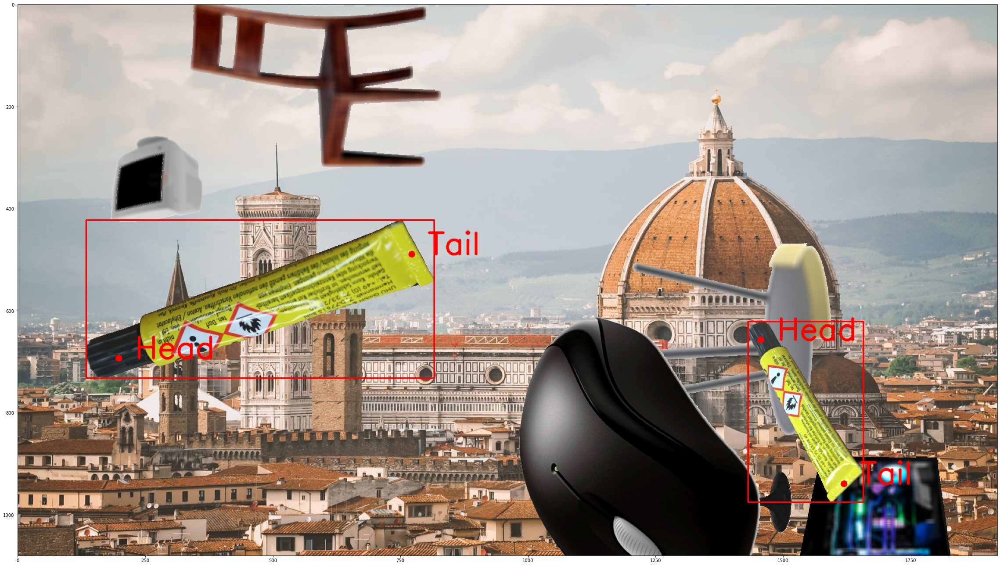

In [44]:
visualize_composition_with_keypoints(img_dataset_example,
                                     keypoints_dataset_example,
                                     keypoints_names,
                                     bboxes_dataset_example)